<a href="https://colab.research.google.com/github/Sushmi-git/Foodvision/blob/main/AI_Nutri_tracker.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install torch torchvision torchmetrics numpy matplotlib opencv-python pycocotools

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 113.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 95.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 55.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 15.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 38.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 981.9/981.9 kB 51.8 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstal

In [ ]:
import os
import torch
import torchvision
import numpy as np
import matplotlib.pyplot as plt
import cv2
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from pycocotools.coco import COCO

In [ ]:
DATASET_PATH = "/content/drive/MyDrive/Food_taste_dataset"

TRAIN_ANNOTATIONS = os.path.join(DATASET_PATH, "train", "_annotations.coco.json")
TEST_ANNOTATIONS = os.path.join(DATASET_PATH, "test", "_annotations.coco.json")
VALID_ANNOTATIONS = os.path.join(DATASET_PATH, "valid", "_annotations.coco.json")

TRAIN_IMAGES = os.path.join(DATASET_PATH, "train")
TEST_IMAGES = os.path.join(DATASET_PATH, "test")
VALID_IMAGES = os.path.join(DATASET_PATH, "valid")

In [ ]:
class COCODataset(Dataset):
    def __init__(self, img_dir, annotation_path, transforms=None):
        self.img_dir = img_dir
        self.coco = COCO(annotation_path)
        self.image_ids = list(self.coco.imgs.keys())
        self.transforms = transforms

    def __len__(self):
        return len(self.image_ids)

    def __getitem__(self, idx):
        image_id = self.image_ids[idx]
        ann_ids = self.coco.getAnnIds(imgIds=image_id)
        annotations = self.coco.loadAnns(ann_ids)

        # Load image
        img_info = self.coco.loadImgs(image_id)[0]
        img_path = os.path.join(self.img_dir, img_info['file_name'])
        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image = image / 255.0  # Normalize to [0,1] range
        image = torch.tensor(image, dtype=torch.float32).permute(2, 0, 1)  # Convert to Tensor

        # Prepare target
        boxes = []
        labels = []
        for ann in annotations:
            xmin, ymin, width, height = ann["bbox"]
            boxes.append([xmin, ymin, xmin + width, ymin + height])
            labels.append(ann["category_id"])

        target = {
            "boxes": torch.tensor(boxes, dtype=torch.float32),
            "labels": torch.tensor(labels, dtype=torch.int64)
        }

        return image, target

In [ ]:
train_dataset = COCODataset(TRAIN_IMAGES, TRAIN_ANNOTATIONS)
test_dataset = COCODataset(TEST_IMAGES, TEST_ANNOTATIONS)
valid_dataset = COCODataset(VALID_IMAGES, VALID_ANNOTATIONS)

train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True, collate_fn=lambda x: tuple(zip(*x)))
valid_loader = DataLoader(valid_dataset, batch_size=4, shuffle=False, collate_fn=lambda x: tuple(zip(*x)))
test_loader = DataLoader(test_dataset, batch_size=4, shuffle=False, collate_fn=lambda x: tuple(zip(*x)))

loading annotations into memory...
Done (t=16.33s)
creating index...
index created!
loading annotations into memory...
Done (t=1.83s)
creating index...
index created!
loading annotations into memory...
Done (t=1.93s)
creating index...
index created!


In [ ]:
num_classes = 38  # Change based on your dataset

model = fasterrcnn_resnet50_fpn(pretrained=True)
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = torchvision.models.detection.faster_rcnn.FastRCNNPredictor(in_features, num_classes)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth
100%|██████████| 160M/160M [00:02<00:00, 60.3MB/s]


FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(

In [ ]:
import torch.optim as optim

optimizer = optim.Adam(model.parameters(), lr=0.0001)

def train_one_epoch(model, optimizer, train_loader, device):
    model.train()
    running_loss = 0.0

    for images, targets in train_loader:
        images = [img.to(device) for img in images]
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        optimizer.zero_grad()
        loss_dict = model(images, targets)
        loss = sum(loss for loss in loss_dict.values())

        loss.backward()
        optimizer.step()
        running_loss += loss.item()

    return running_loss / len(train_loader)

def validate(model, val_loader, device):
    model.train()  # Set to training mode to compute loss
    val_loss = 0.0

    with torch.no_grad():
        for images, targets in val_loader:
            images = [img.to(device) for img in images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            loss_dict = model(images, targets)
            loss = sum(loss for loss in loss_dict.values())
            val_loss += loss.item()

    model.eval()  # Switch back to evaluation mode after validation
    return val_loss / len(val_loader) if val_loader else 0

In [ ]:
EPOCHS = 3

for epoch in range(EPOCHS):
    try:
        train_loss = train_one_epoch(model, optimizer, train_loader, device)
        print(f"✅ Epoch {epoch+1}/{EPOCHS} - Train Loss: {train_loss:.4f}")
    except Exception as e:
        print(f" Error in training at epoch {epoch+1}: {e}")

KeyboardInterrupt: 

In [ ]:
for epoch in range(EPOCHS):
    try:
        val_loss = validate(model, valid_loader, device)
        print(f"✅ Epoch {epoch+1}/{EPOCHS} - Val Loss: {val_loss:.4f}")
    except Exception as e:
        print(f"⚠️ Error in validation at epoch {epoch+1}: {e}")

✅ Epoch 1/3 - Val Loss: 0.4008
✅ Epoch 2/3 - Val Loss: 0.3999
✅ Epoch 3/3 - Val Loss: 0.3999


In [ ]:
torch.save(model.state_dict(), "food_detection.pth")
print("✅ Model saved successfully!")

✅ Model saved successfully!


In [ ]:
import json

# Load the COCO annotation file
ANNOTATION_FILE = TEST_ANNOTATIONS  # Change to your file path if needed
with open(ANNOTATION_FILE, "r") as f:
    coco_data = json.load(f)

# Create a dictionary mapping class IDs to names
category_mapping = {cat["id"]: cat["name"] for cat in coco_data["categories"]}

print(category_mapping)  # Example output: {1: "Burger", 2: "Fries", 3: "Nuggets", ...}

{0: 'Food', 1: 'AW cola', 2: 'Beijing Beef', 3: 'Chow Mein', 4: 'Fried Rice', 5: 'Hashbrown', 6: 'Honey Walnut Shrimp', 7: 'Kung Pao Chicken', 8: 'String Bean Chicken Breast', 9: 'Super Greens', 10: 'The Original Orange Chicken', 11: 'White Steamed Rice', 12: 'black pepper rice bowl', 13: 'burger', 14: 'carrot_eggs', 15: 'cheese burger', 16: 'chicken waffle', 17: 'chicken_nuggets', 18: 'chinese_cabbage', 19: 'chinese_sausage', 20: 'crispy corn', 21: 'curry', 22: 'french fries', 23: 'fried chicken', 24: 'fried_chicken', 25: 'fried_dumplings', 26: 'fried_eggs', 27: 'mango chicken pocket', 28: 'mozza burger', 29: 'mung_bean_sprouts', 30: 'nugget', 31: 'perkedel', 32: 'rice', 33: 'sprite', 34: 'tostitos cheese dip sauce', 35: 'triangle_hash_brown', 36: 'water_spinach'}


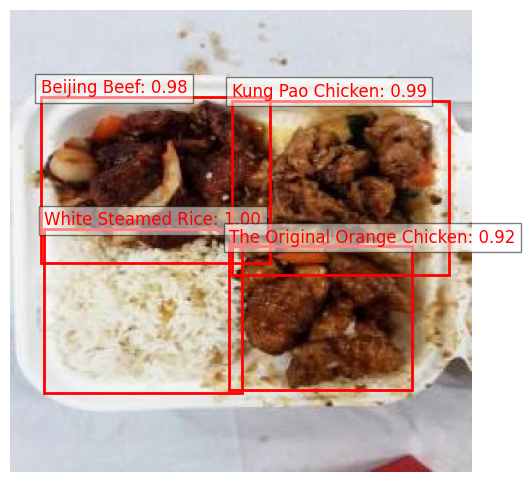

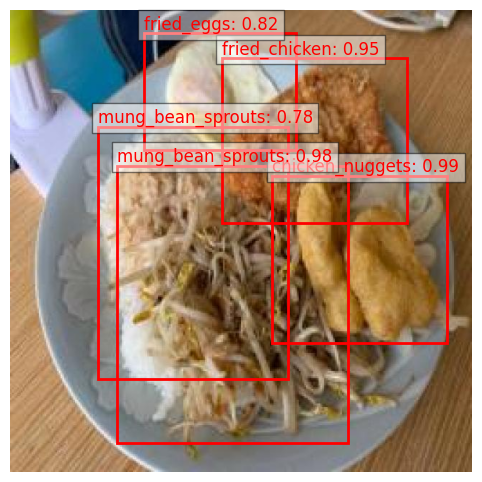

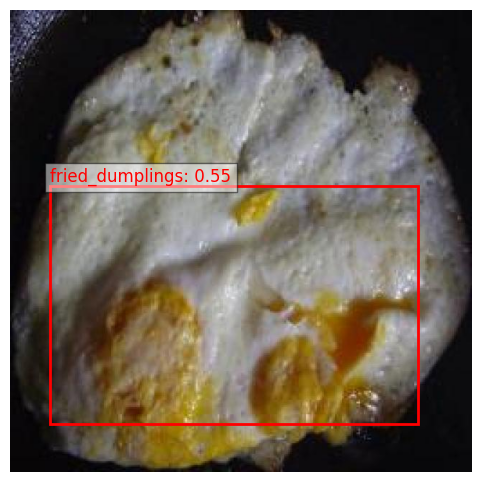

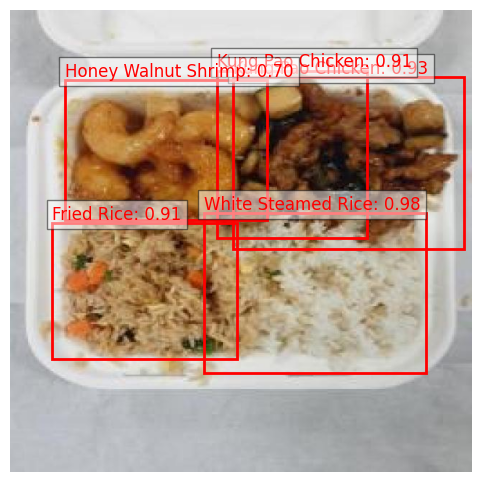

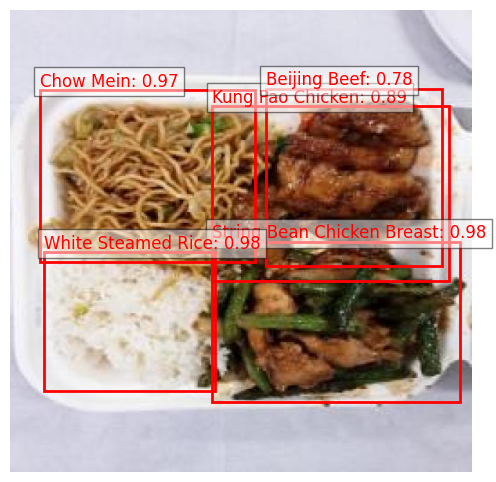

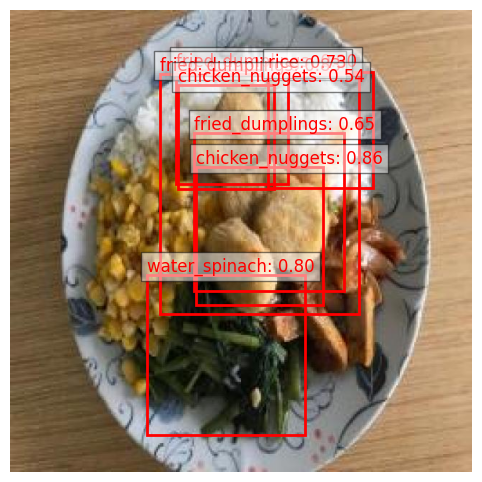

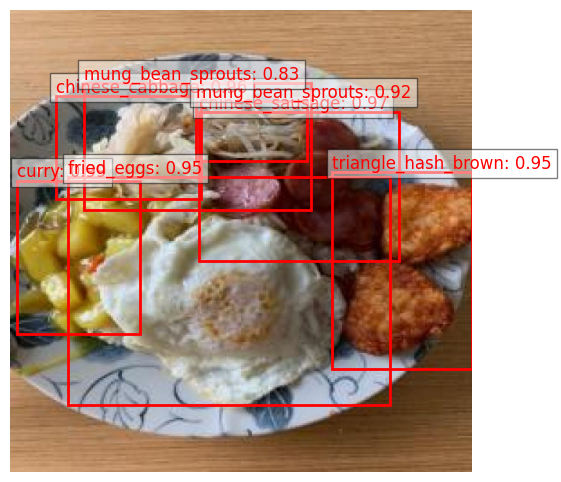

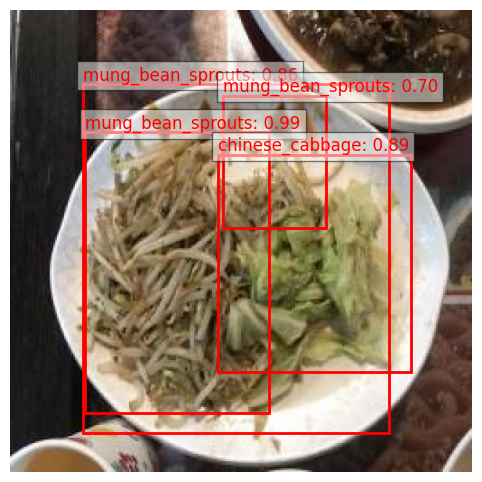

Error: Unable to load image /content/drive/MyDrive/Food_taste_dataset/test/_annotations.coco.json


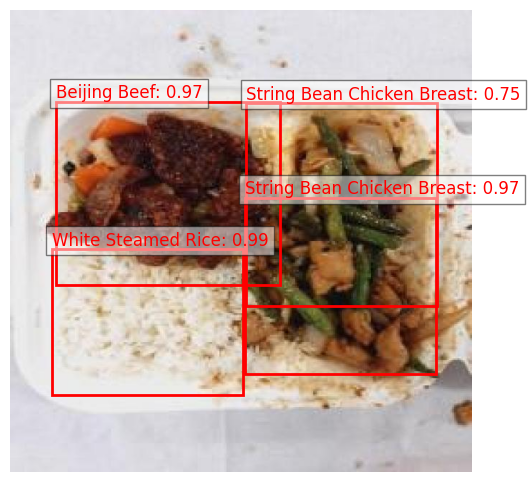

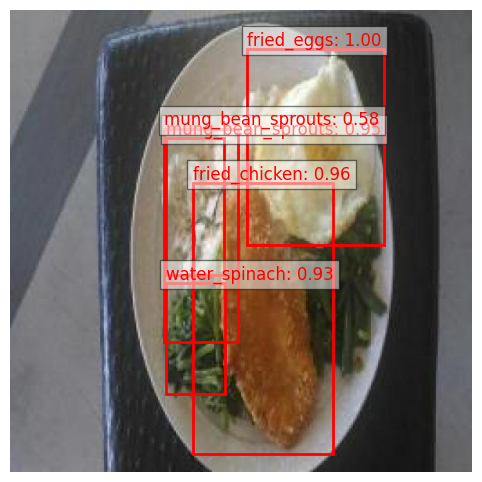

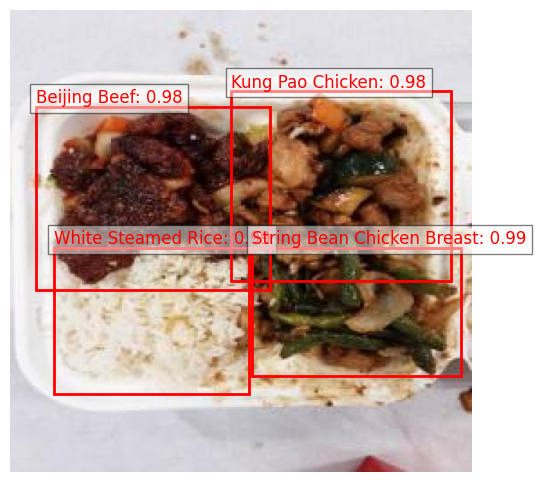

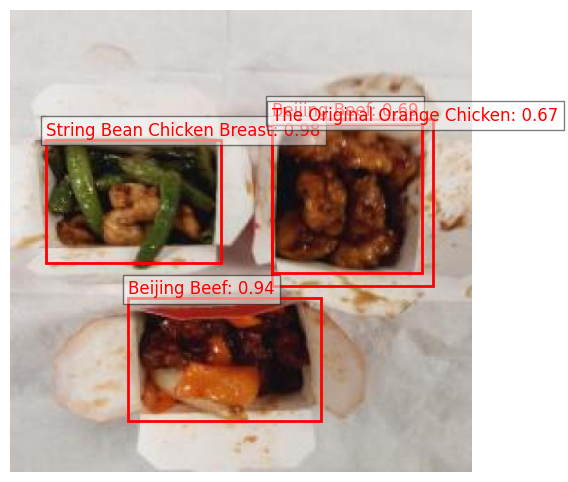

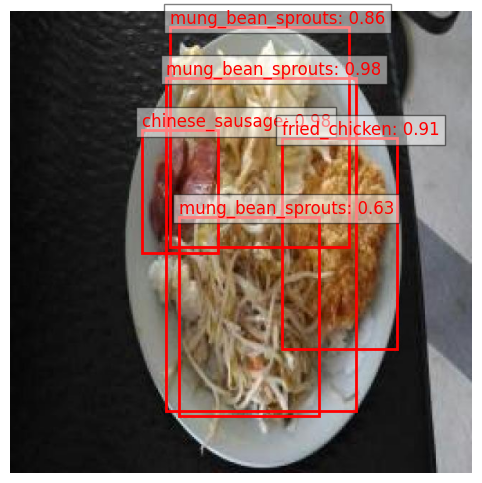

...

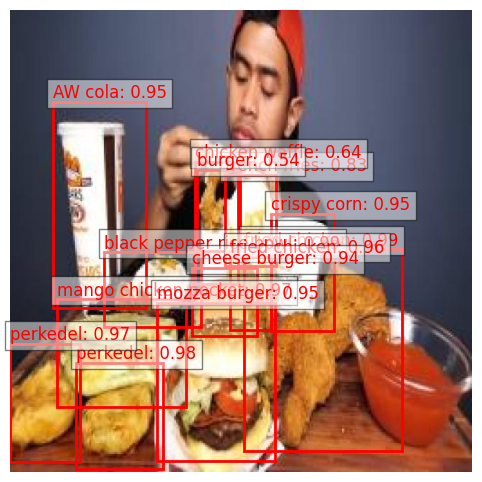

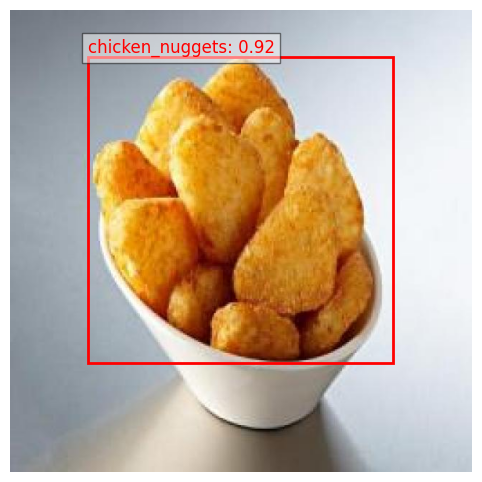

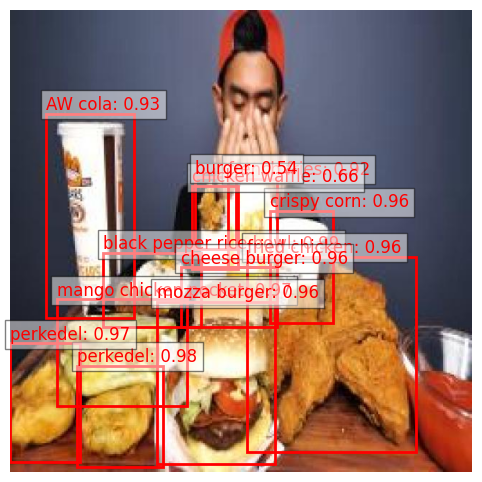

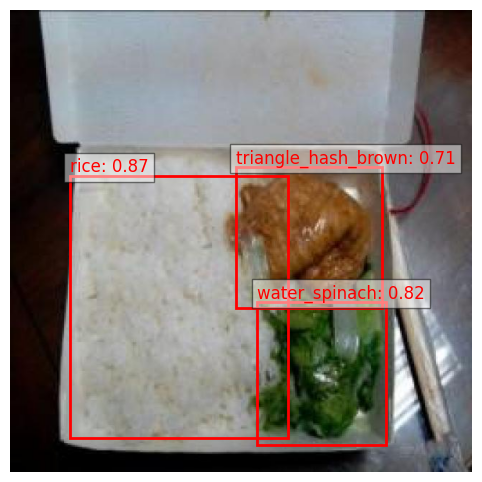

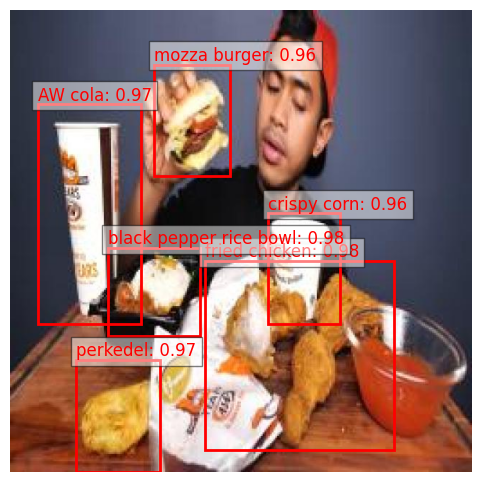

Error: Unable to load image /content/drive/MyDrive/Food_taste_dataset/test/test.code-workspace


In [ ]:
import os
import json
import torch
import cv2
import random
import matplotlib.pyplot as plt
import torchvision.transforms as transforms

# Load the COCO annotation file
# Load the COCO annotation file
ANNOTATION_FILE = TEST_ANNOTATIONS  # Change to your file path if needed
with open(ANNOTATION_FILE, "r") as f:
    coco_data = json.load(f)

# Create a dictionary mapping class IDs to names
category_mapping = {cat["id"]: cat["name"] for cat in coco_data["categories"]}

# Load the trained model
model.eval()

# Define the test folder path
test_folder = "/content/drive/MyDrive/Food_taste_dataset/test"  # Replace with your test images folder

# Image transformation (resize, normalize)
transform = transforms.Compose([
    transforms.ToTensor(),
])

# Function to perform inference
def predict_image(image_path, model, device):
    image = cv2.imread(image_path)
    if image is None:
        print(f"Error: Unable to load image {image_path}")
        return None, None
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image_tensor = transform(image).unsqueeze(0).to(device)

    with torch.no_grad():
        output = model(image_tensor)[0]  # Get first output

    return image, output

# Run inference on test images
for image_name in os.listdir(test_folder):
    image_path = os.path.join(test_folder, image_name)

    # Run model prediction
    image, output = predict_image(image_path, model, device)
    if image is None or output is None:
        continue

    # Extract detected boxes, labels, and confidence scores
    pred_boxes = output["boxes"].cpu().numpy()
    pred_labels = output["labels"].cpu().numpy()
    pred_scores = output["scores"].cpu().numpy()

    # Confidence threshold for displaying detections
    threshold = 0.5
    filtered_indices = pred_scores > threshold
    pred_boxes = pred_boxes[filtered_indices]
    pred_labels = pred_labels[filtered_indices]
    pred_scores = pred_scores[filtered_indices]

    # Convert IDs to class names
    class_names = [category_mapping[label] for label in pred_labels]

    # Visualize predictions
    plt.figure(figsize=(8, 6))
    plt.imshow(image)
    ax = plt.gca()

    for box, label, score in zip(pred_boxes, class_names, pred_scores):
        x1, y1, x2, y2 = box.astype(int)
        rect = plt.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=2, edgecolor="red", facecolor="none")
        ax.add_patch(rect)
        ax.text(x1, y1 - 5, f"{label}: {score:.2f}", color="red", fontsize=12, bbox=dict(facecolor="white", alpha=0.5))

    plt.axis("off")
    plt.show()

In [ ]:
import torch
import json
from torchmetrics.detection.mean_ap import MeanAveragePrecision
from torchvision.transforms import functional as F
from PIL import Image

# Load the COCO annotation file
ANNOTATION_FILE = TEST_ANNOTATIONS  # Change to your file path if needed
with open(ANNOTATION_FILE, "r") as f:
    coco_data = json.load(f)

# Create a dictionary mapping class IDs to names
category_mapping = {cat["id"]: cat["name"] for cat in coco_data["categories"]}

# Initialize the mAP metric
map_metric = MeanAveragePrecision(box_format="xyxy", iou_type="bbox")

# Function to convert COCO annotations to evaluation format
def get_ground_truth(image_id):
    """Returns ground truth boxes and labels for a given image ID."""
    gt_boxes = []
    gt_labels = []

    for ann in coco_data["annotations"]:
        if ann["image_id"] == image_id:
            x, y, width, height = ann["bbox"]
            gt_boxes.append([x, y, x + width, y + height])  # Convert to xyxy format
            gt_labels.append(ann["category_id"])  # Class label

    return {"boxes": torch.tensor(gt_boxes, dtype=torch.float32),
            "labels": torch.tensor(gt_labels, dtype=torch.int64)}

# Evaluate model on test set
model.eval()
predictions = []
ground_truths = []

for image_info in coco_data["images"]:
    image_id = image_info["id"]
    image_path = f"/content/drive/MyDrive/Food_taste_dataset/test/{image_info['file_name']}"  # Update path

    # Load and preprocess image
    image = Image.open(image_path).convert("RGB")
    image_tensor = F.to_tensor(image).unsqueeze(0).to(device)

    # Run inference
    with torch.no_grad():
        pred = model(image_tensor)[0]

    # Convert predictions to evaluation format
    pred_boxes = pred["boxes"].cpu()
    pred_labels = pred["labels"].cpu()
    pred_scores = pred["scores"].cpu()

    # Store predictions and ground truths
    predictions.append({"boxes": pred_boxes, "scores": pred_scores, "labels": pred_labels})
    ground_truths.append(get_ground_truth(image_id))

# Compute mAP
map_metric.update(predictions, ground_truths)
result = map_metric.compute()

# Print mAP results
print(f"mAP@0.5: {result['map_50']:.4f}")
print(f"mAP@0.5:0.95: {result['map']:.4f}")

mAP@0.5: 0.8457
mAP@0.5:0.95: 0.4785


In [ ]:
pip install fuzzywuzzy

/usr/local/lib/python3.11/dist-packages/fuzzywuzzy/fuzz.py:11: UserWarning: Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning
  warnings.warn('Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning')


Enter age group (e.g., adult_male, child_4_8): adult_male


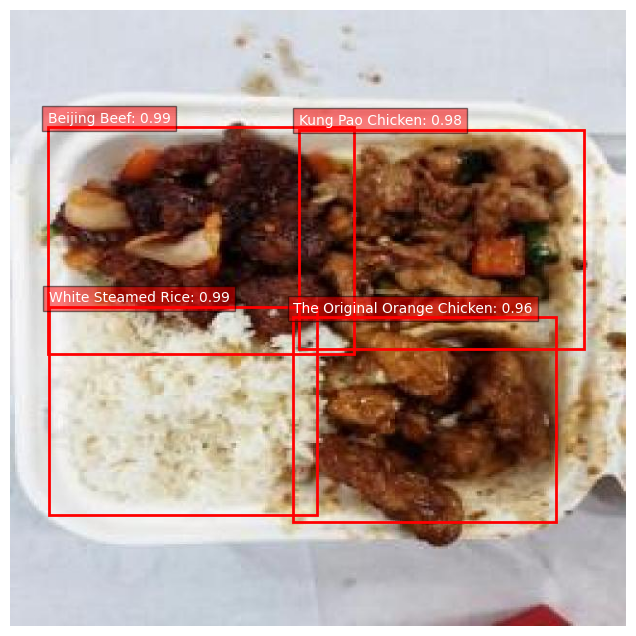


🔍 Processing: Beijing Beef
✅ Using matched name: BEIJING SWEET & TANGY SAUCE
{
    "Calories": 167.0,
    "Protein": 0.0,
    "Carbohydrates": 38.89,
    "Fat": 0.0,
    "Sodium": 611.0
}

🔍 Processing: White Steamed Rice
✅ Using matched name: Rice, white, steamed, Chinese restaurant
{
    "Calories": 151.0,
    "Protein": 3.2,
    "Carbohydrates": 33.88,
    "Fat": 0.27,
    "Sodium": 5.0
}

🔍 Processing: Kung Pao Chicken
✅ Using matched name: Kung pao chicken
{
    "Calories": 129,
    "Protein": 9.76,
    "Carbohydrates": 6.87,
    "Fat": 6.98,
    "Sodium": 402
}

🔍 Processing: The Original Orange Chicken
✅ Using matched name: Orange chicken
{
    "Calories": 262,
    "Protein": 14.5,
    "Carbohydrates": 22.5,
    "Fat": 12.7,
    "Sodium": 553
}

📊 Nutrition Summary vs RDA:
{
    "Calories": {
        "value": 709.0,
        "RDA": 2500,
        "percentage": 28.4
    },
    "Protein": {
        "value": 27.46,
        "RDA": 56,
        "percentage": 49.0
    },
    "Carbohydra

In [ ]:
import json
import torch
import random
import re
import requests
import matplotlib.pyplot as plt
from fuzzywuzzy import fuzz, process

# API Keys
USDA_API_KEY = "MhGg5wNKenUlxwKKA7U8wvOTg7IvGmj2BGQrA8dd"
GROQ_API_KEY = "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"

# Age-based RDA data
RDA_DATA = {
    "child_1_3": {"Calories": 1000, "Protein": 13, "Carbohydrates": 130, "Fat": 35},
    "child_4_8": {"Calories": 1400, "Protein": 19, "Carbohydrates": 180, "Fat": 40},
    "child_9_13": {"Calories": 1800, "Protein": 34, "Carbohydrates": 220, "Fat": 55},
    "teen_male_14_18": {"Calories": 2800, "Protein": 52, "Carbohydrates": 300, "Fat": 80},
    "teen_female_14_18": {"Calories": 2200, "Protein": 46, "Carbohydrates": 275, "Fat": 70},
    "adult_male": {"Calories": 2500, "Protein": 56, "Carbohydrates": 300, "Fat": 70},
    "adult_female": {"Calories": 2000, "Protein": 46, "Carbohydrates": 275, "Fat": 60},
    "elderly_male": {"Calories": 2200, "Protein": 65, "Carbohydrates": 280, "Fat": 65},
    "elderly_female": {"Calories": 1800, "Protein": 60, "Carbohydrates": 250, "Fat": 55}
}

NUTRIENT_IDS = {
    "Calories": 1008,
    "Protein": 1003,
    "Carbohydrates": 1005,
    "Fat": 1004,
    "Sodium": 1093
}

def preprocess_food_name(name):
    name = name.lower()
    name = re.sub(r'[^a-z\s]', '', name)
    return name.strip()

def query_usda_food_api(food_name):
    cleaned_food_name = preprocess_food_name(food_name)
    search_url = f"https://api.nal.usda.gov/fdc/v1/foods/search?query={cleaned_food_name}&api_key={USDA_API_KEY}"
    response = requests.get(search_url)

    if response.status_code == 200:
        data = response.json()
        if "foods" in data and len(data["foods"]) > 0:
            food_names = [preprocess_food_name(food["description"]) for food in data["foods"]]
            closest_match, score = process.extractOne(cleaned_food_name, food_names, scorer=fuzz.partial_ratio)

            if score < 70:
                print(f"\n⚠️  Detected label '{food_name}' may be incorrect (low match score: {score}).")
                corrected_name = input("Please enter a corrected name (or press Enter to skip): ")
                if corrected_name:
                    return query_usda_food_api(corrected_name)
                else:
                    return None

            matched_food = next(food for food in data["foods"] if preprocess_food_name(food["description"]) == closest_match)
            return matched_food
    return None

def get_nutrition_data(fdc_id):
    url = f"https://api.nal.usda.gov/fdc/v1/food/{fdc_id}?api_key={USDA_API_KEY}"
    response = requests.get(url)
    return response.json() if response.status_code == 200 else None

def extract_key_nutrients(nutrition_data):
    nutrients = {key: 0 for key in NUTRIENT_IDS.keys()}
    for nutrient in nutrition_data.get("foodNutrients", []):
        nutrient_id = nutrient.get("nutrient", {}).get("id")
        for key, usda_id in NUTRIENT_IDS.items():
            if nutrient_id == usda_id:
                nutrients[key] = nutrient.get("amount", 0)
    return nutrients

def compare_with_rda(nutrition, age_group):
    rda = RDA_DATA.get(age_group, {})
    return {
        key: {
            "value": nutrition.get(key, 0),
            "RDA": rda.get(key, 0),
            "percentage": round((nutrition.get(key, 0) / rda.get(key, 1)) * 100, 1)
        }
        for key in RDA_DATA["adult_male"].keys()
    }

def get_groq_suggestions(food_name, nutrition, age_group):
    rda = RDA_DATA.get(age_group, {})
    prompt = f"""
    A {age_group.replace('_', ' ')} should consume:
    Calories: {rda['Calories']} kcal, Protein: {rda['Protein']} g,
    Carbohydrates: {rda['Carbohydrates']} g, Fat: {rda['Fat']} g

    This meal has:
    {food_name}
    Calories: {nutrition['Calories']}, Protein: {nutrition['Protein']},
    Carbs: {nutrition['Carbohydrates']}, Fat: {nutrition['Fat']}, Sodium: {nutrition['Sodium']}

    Suggest modifications to balance this meal.
    """
    url = "https://api.groq.com/openai/v1/chat/completions"
    headers = {"Authorization": f"Bearer {GROQ_API_KEY}", "Content-Type": "application/json"}
    data = {
        "model": "llama3-70b-8192",
        "messages": [{"role": "user", "content": prompt}],
        "temperature": 0.7
    }
    response = requests.post(url, headers=headers, json=data)
    return response.json()["choices"][0]["message"]["content"] if response.status_code == 200 else "Error getting suggestions."

def deduplicate_similar_foods(food_list):
    unique = []
    for item in food_list:
        if not any(fuzz.ratio(item, existing) > 80 for existing in unique):
            unique.append(item)
    return unique

def detect_and_process_food():
    random_index = random.randint(0, len(test_dataset) - 1)
    image, _ = test_dataset[random_index]
    image_np = image.permute(1, 2, 0).numpy()

    model.eval()
    with torch.no_grad():
        prediction = model([image.to(device)])

    boxes = prediction[0]['boxes'].cpu().numpy()
    labels = prediction[0]['labels'].cpu().numpy()
    scores = prediction[0]['scores'].cpu().numpy()
    threshold = 0.5

    filtered = scores > threshold
    boxes = boxes[filtered]
    labels = labels[filtered]
    scores = scores[filtered]
    foods = [category_mapping[label] for label in labels]

    # Visualize
    plt.figure(figsize=(8, 8))
    plt.imshow(image_np)
    ax = plt.gca()
    for box, label, score in zip(boxes, foods, scores):
        xmin, ymin, xmax, ymax = box
        ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin, edgecolor='red', fill=False, linewidth=2))
        ax.text(xmin, ymin - 5, f"{label}: {score:.2f}", color='white', fontsize=10, bbox=dict(facecolor='red', alpha=0.5))
    plt.axis("off")
    plt.show()

    # Remove similar duplicates
    return deduplicate_similar_foods(foods)

def main():
    age_group = input("Enter age group (e.g., adult_male, child_4_8): ").strip()
    detected_foods = detect_and_process_food()

    total_nutrition = {key: 0 for key in NUTRIENT_IDS}

    for food_name in detected_foods:
        print(f"\n🔍 Processing: {food_name}")
        result = query_usda_food_api(food_name)

        if not result:
            print(f"❌ Could not recognize '{food_name}'. Please provide a common name.")
            user_input = input("Enter common name: ").strip()
            result = query_usda_food_api(user_input)
            if not result:
                print("❌ Skipping unrecognized item.")
                continue

        matched_name = result["description"]
        print(f"✅ Using matched name: {matched_name}")
        fdc_id = result["fdcId"]
        nutrition = get_nutrition_data(fdc_id)

        if nutrition:
            nutrients = extract_key_nutrients(nutrition)
            for key in total_nutrition:
                total_nutrition[key] += nutrients.get(key, 0)
            print(json.dumps(nutrients, indent=4))
        else:
            print(f"⚠️ Could not retrieve data for {matched_name}")

    if total_nutrition["Calories"] > 0:
        print("\n📊 Nutrition Summary vs RDA:")
        comparison = compare_with_rda(total_nutrition, age_group)
        print(json.dumps(comparison, indent=4))

        print("\n💡 Groq Meal Suggestions:")
        suggestions = get_groq_suggestions("Mixed meal", total_nutrition, age_group)
        print(suggestions)

if __name__ == "__main__":
    main()


In [ ]:
# Install additional required packages for web app
!pip install flask pyngrok fuzzywuzzy python-Levenshtein flask-ngrok

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 161.7/161.7 kB 7.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 61.5 MB/s eta 0:00:00


In [ ]:
# Import necessary libraries
import os
import torch
import torchvision
import numpy as np
import re
import matplotlib.pyplot as plt
import cv2
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from pycocotools.coco import COCO
import requests
import json
import base64
import io
from PIL import Image
from fuzzywuzzy import process
import threading
import time
from google.colab import files
from IPython.display import display, HTML, IFrame
from collections import defaultdict
from flask import Flask, request, jsonify, render_template_string, redirect, session, url_for
from flask_ngrok import run_with_ngrok
from pyngrok import ngrok
import threading

In [ ]:
!ngrok authtoken 2vE2a7mErPC9GJgOrrNhiB1mF48_2wsZPdD7U4yEFxhLWgmZE

In [ ]:
# Define global variables that will be used throughout the app
# API Keys - replace with your actual keys
USDA_API_KEY = "MhGg5wNKenUlxwKKA7U8wvOTg7IvGmj2BGQrA8dd"  # Replace with your key
GROQ_API_KEY = "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"  # Replace with your key

# Age-based RDA dataset
RDA_DATA = {
    "child_1_3": {"Calories": 1000, "Protein": 13, "Carbohydrates": 130, "Fat": 35},
    "child_4_8": {"Calories": 1400, "Protein": 19, "Carbohydrates": 180, "Fat": 40},
    "child_9_13": {"Calories": 1800, "Protein": 34, "Carbohydrates": 220, "Fat": 55},
    "teen_male_14_18": {"Calories": 2800, "Protein": 52, "Carbohydrates": 300, "Fat": 80},
    "teen_female_14_18": {"Calories": 2200, "Protein": 46, "Carbohydrates": 275, "Fat": 70},
    "adult_male": {"Calories": 2500, "Protein": 56, "Carbohydrates": 300, "Fat": 70},
    "adult_female": {"Calories": 2000, "Protein": 46, "Carbohydrates": 275, "Fat": 60},
    "elderly_male": {"Calories": 2200, "Protein": 65, "Carbohydrates": 280, "Fat": 65},
    "elderly_female": {"Calories": 1800, "Protein": 60, "Carbohydrates": 250, "Fat": 55}
}

# Standardized USDA Nutrient IDs
NUTRIENT_IDS = {
    "Calories": 1008,
    "Protein": 1003,
    "Carbohydrates": 1005,
    "Fat": 1004,
    "Sodium": 1093
}

# Create a folder to store uploaded files
upload_folder = 'uploaded_images'
os.makedirs(upload_folder, exist_ok=True)

# Load category mapping from the test annotations
def load_category_mapping():
    """Load class ID to category name mapping from annotations"""
    with open(TEST_ANNOTATIONS, "r") as f:
        coco_data = json.load(f)
    return {cat["id"]: cat["name"] for cat in coco_data["categories"]}

# Utility functions for food detection and nutrition analysis
def query_usda_food_api(food_name):
    """Query the USDA API with the food name and fetch the closest match using fuzzy matching."""
    search_url = f"https://api.nal.usda.gov/fdc/v1/foods/search?query={food_name}&api_key={USDA_API_KEY}"
    response = requests.get(search_url)

    if response.status_code == 200:
        data = response.json()
        if "foods" in data and len(data["foods"]) > 0:
            # Extract all food descriptions and fuzzy match with the input food name
            food_names = [food["description"] for food in data["foods"]]
            closest_match, score = process.extractOne(food_name, food_names)
            if score > 80:  # Only consider matches with a good similarity score
                matched_food = next(food for food in data["foods"] if food["description"] == closest_match)
                return matched_food
    return None

def get_nutrition_data(fdc_id):
    """Fetch nutrition data for a given FDC ID."""
    food_url = f"https://api.nal.usda.gov/fdc/v1/food/{fdc_id}?api_key={USDA_API_KEY}"
    response = requests.get(food_url)
    return response.json() if response.status_code == 200 else None

def extract_key_nutrients(nutrition_data):
    """Extract only required nutrients using USDA standard nutrient IDs."""
    extracted_nutrients = {key: 0 for key in NUTRIENT_IDS.keys()}
    if "foodNutrients" in nutrition_data:
        for nutrient in nutrition_data["foodNutrients"]:
            nutrient_id = nutrient.get("nutrient", {}).get("id")
            for key, usda_id in NUTRIENT_IDS.items():
                if nutrient_id == usda_id:
                    extracted_nutrients[key] = nutrient.get("amount", 0)
    return extracted_nutrients

def compare_with_rda(nutrition, age_group):
    """Compare meal's nutrition with RDA values."""
    rda = RDA_DATA.get(age_group, {})
    comparison = {key: {"value": nutrition.get(key, 0), "RDA": rda.get(key, 0),
                "percentage": round((nutrition.get(key, 0) / rda.get(key, 1)) * 100, 1)}
                for key in RDA_DATA["adult_male"].keys()}
    return comparison

def get_groq_suggestions(food_name, nutrition, age_group):
    """Use Groq LLM to suggest meal improvements based on deficiencies."""
    rda = RDA_DATA.get(age_group, {})
    prompt = f"""
    A {age_group.replace('_', ' ')} should consume daily:
    Calories: {rda.get('Calories', 'N/A')} kcal
    Protein: {rda.get('Protein', 'N/A')} g
    Carbohydrates: {rda.get('Carbohydrates', 'N/A')} g
    Fat: {rda.get('Fat', 'N/A')} g

    The meal currently contains:
    Food: {food_name}
    Calories: {nutrition.get('Calories', 0)} kcal
    Protein: {nutrition.get('Protein', 0)} g
    Carbohydrates: {nutrition.get('Carbohydrates', 0)} g
    Fat: {nutrition.get('Fat', 0)} g
    Sodium: {nutrition.get('Sodium', 0)} mg

    Suggest modifications to balance the meal and improve nutrition.
    """
    url = "https://api.groq.com/openai/v1/chat/completions"
    headers = {"Authorization": f"Bearer {GROQ_API_KEY}", "Content-Type": "application/json"}
    data = {"model": "llama3-70b-8192", "messages": [{"role": "user", "content": prompt}], "temperature": 0.7}
    try:
        response = requests.post(url, headers=headers, json=data)
        if response.status_code == 200:
            return response.json()["choices"][0]["message"]["content"]
    except Exception as e:
        print(f"Error with Groq API: {e}")
    return "Could not fetch meal suggestions."

def predict_image(image, threshold=0.5):
    """Run inference on an image using the model."""
    # Convert image to tensor
    if isinstance(image, np.ndarray):
        # If image is already numpy array, convert to tensor
        image_tensor = torch.tensor(image, dtype=torch.float32).permute(2, 0, 1) / 255.0
    else:
        # If image is PIL or other format, convert to numpy first
        image = np.array(image)
        image_tensor = torch.tensor(image, dtype=torch.float32).permute(2, 0, 1) / 255.0

    image_tensor = image_tensor.unsqueeze(0).to(device)

    with torch.no_grad():
        prediction = model(image_tensor)[0]

    # Extract predictions
    pred_boxes = prediction['boxes'].cpu().numpy()
    pred_labels = prediction['labels'].cpu().numpy()
    pred_scores = prediction['scores'].cpu().numpy()

    # Filter by threshold
    filtered_indices = pred_scores > threshold
    pred_boxes = pred_boxes[filtered_indices]
    pred_labels = pred_labels[filtered_indices]
    pred_scores = pred_scores[filtered_indices]

    # Convert to class names
    category_mapping = load_category_mapping()
    class_names = [category_mapping.get(label, f"Class_{label}") for label in pred_labels]

    return pred_boxes, class_names, pred_scores

def visualize_detection(image, boxes, labels, scores):
    """Generate visualization of detection results."""
    # Create a copy of the image for drawing
    image_draw = image.copy()

    # Convert image to RGB if it's BGR (OpenCV format)
    if len(image_draw.shape) == 3 and image_draw.shape[2] == 3:
        if not isinstance(image_draw, np.ndarray):
            image_draw = np.array(image_draw)

    plt.figure(figsize=(12, 8))
    plt.imshow(image_draw)
    ax = plt.gca()

    # Draw bounding boxes and labels
    for box, label, score in zip(boxes, labels, scores):
        xmin, ymin, xmax, ymax = box.astype(int)
        rect = plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                           linewidth=2, edgecolor='red', facecolor='none')
        ax.add_patch(rect)
        ax.text(xmin, ymin - 5, f"{label}: {score:.2f}",
               color='white', fontsize=12,
               bbox=dict(facecolor='red', alpha=0.5))

    plt.axis('off')

    # Convert plot to image
    buf = io.BytesIO()
    plt.savefig(buf, format='png', bbox_inches='tight', pad_inches=0.1)
    buf.seek(0)
    img_str = base64.b64encode(buf.getvalue()).decode('utf-8')
    plt.close()

    return f"data:image/png;base64,{img_str}"

# Define the HTML templates as strings
index_html = """
<!DOCTYPE html>
<html lang="en">
<head>
    <meta charset="UTF-8">
    <meta name="viewport" content="width=device-width, initial-scale=1.0">
    <title>Food Nutrition Analyzer</title>
    <link href="https://cdn.jsdelivr.net/npm/bootstrap@5.3.0-alpha1/dist/css/bootstrap.min.css" rel="stylesheet">
    <style>
        .header {
            background-color: #4CAF50;
            color: white;
            padding: 20px 0;
            margin-bottom: 30px;
        }
        .upload-container {
            max-width: 600px;
            margin: 0 auto;
            padding: 20px;
            border-radius: 10px;
            box-shadow: 0 0 10px rgba(0,0,0,0.1);
            background-color: #f9f9f9;
        }
        .footer {
            text-align: center;
            margin-top: 50px;
            padding: 20px;
            background-color: #f5f5f5;
        }
    </style>
</head>
<body>
    <div class="header">
        <div class="container">
            <h1 class="text-center">Food Nutrition Analyzer</h1>
            <p class="text-center">Upload an image of your meal to get nutrition information and personalized recommendations</p>
        </div>
    </div>

    <div class="container">
        <div class="upload-container">
            <h2 class="mb-4">Analyze Your Meal</h2>

            <form action="/upload" method="post" enctype="multipart/form-data">
                <div class="mb-3">
                    <label for="file" class="form-label">Upload Food Image</label>
                    <input type="file" class="form-control" id="file" name="file" accept="image/*" required>
                </div>

                <div class="mb-3">
                    <label for="age_group" class="form-label">Select Age Group</label>
                    <select class="form-select" id="age_group" name="age_group">
                        {% for age_group in age_groups %}
                        <option value="{{ age_group }}">{{ age_group.replace('_', ' ').title() }}</option>
                        {% endfor %}
                    </select>
                </div>

                <button type="submit" class="btn btn-success w-100 mt-3">Analyze Meal</button>
            </form>

            <div class="mt-4">
                <h5>How it works:</h5>
                <ol>
                    <li>Upload a photo of your meal</li>
                    <li>Our AI will detect food items in the image</li>
                    <li>We'll analyze the nutritional content</li>
                    <li>Get personalized recommendations based on your age group</li>
                </ol>
            </div>
        </div>
    </div>

    <div class="footer">
        <div class="container">
            <p>Food Nutrition Analyzer &copy; 2025</p>
        </div>
    </div>

    <script src="https://cdn.jsdelivr.net/npm/bootstrap@5.3.0-alpha1/dist/js/bootstrap.bundle.min.js"></script>
</body>
</html>
"""

results_html = """
<!DOCTYPE html>
<html lang="en">
<head>
    <meta charset="UTF-8">
    <meta name="viewport" content="width=device-width, initial-scale=1.0">
    <title>Food Analysis Results</title>
    <link href="https://cdn.jsdelivr.net/npm/bootstrap@5.3.0-alpha1/dist/css/bootstrap.min.css" rel="stylesheet">
    <style>
        .header {
            background-color: #4CAF50;
            color: white;
            padding: 20px 0;
            margin-bottom: 30px;
        }
        .result-container {
            margin-bottom: 30px;
            border-radius: 10px;
            box-shadow: 0 0 10px rgba(0,0,0,0.1);
            background-color: #f9f9f9;
            padding: 20px;
        }
        .detection-image {
            max-width: 100%;
            border-radius: 8px;
            margin-bottom: 20px;
        }
        .nutrient-progress {
            height: 25px;
            margin-bottom: 10px;
        }
        .food-item {
            border-left: 4px solid #4CAF50;
            padding-left: 15px;
            margin-bottom: 15px;
        }
        .suggestions {
            background-color: #e8f5e9;
            border-radius: 8px;
            padding: 20px;
            margin-top: 20px;
        }
        .footer {
            text-align: center;
            margin-top: 50px;
            padding: 20px;
            background-color: #f5f5f5;
        }
    </style>
</head>
<body>
    <div class="header">
        <div class="container">
            <h1 class="text-center">Food Analysis Results</h1>
        </div>
    </div>

    <div class="container">
        <div class="row">
            <div class="col-md-12 mb-4">
                <a href="/" class="btn btn-outline-success mb-3">← Back to Home</a>
                <div class="result-container">
                    <h2>Detection Results</h2>
                    <img src="{{ result_image }}" alt="Detection Results" class="detection-image">

                    <h4>Detected Foods:</h4>
                    <ul class="list-group mb-3">
                        {% for food in detected_foods %}
                        <li class="list-group-item">{{ food }}</li>
                        {% endfor %}
                    </ul>
                </div>
            </div>

            {% if total_nutrition.Calories > 0 %}
            <div class="col-md-6">
                <div class="result-container">
                    <h2>Nutrition Summary</h2>
                    <p>Based on {{ age_group.replace('_', ' ').title() }} daily requirements:</p>

                    {% for nutrient, data in comparison.items() %}
                    <div class="mb-3">
                        <label>{{ nutrient }}: {{ data.value|round(1) }} / {{ data.RDA }} ({{ data.percentage }}%)</label>
                        <div class="progress nutrient-progress">
                            {% set capped_percentage = data.percentage if data.percentage <= 100 else 100 %}
                            <div class="progress-bar {% if data.percentage > 100 %}bg-danger{% elif data.percentage > 75 %}bg-warning{% else %}bg-success{% endif %}"
                                role="progressbar"
                                style="width: {{ capped_percentage }}%"
                                aria-valuenow="{{ data.percentage }}"
                                aria-valuemin="0"
                                aria-valuemax="100">
                                {{ data.percentage }}%
                            </div>
                        </div>
                    </div>
                    {% endfor %}

                    <div class="mt-3">
                        <p><strong>Sodium:</strong> {{ total_nutrition.Sodium|round(1) }} mg</p>
                    </div>
                </div>
            </div>

            <div class="col-md-6">
                <div class="result-container">
                    <h2>Nutritional Analysis</h2>

                    {% for food_data in nutrition_details %}
                    <div class="food-item">
                        <h5>{{ food_data.food_name }}</h5>
                        <p class="text-muted">Mapped to: {{ food_data.mapped_name }}</p>
                        <ul>
                            {% for nutrient, value in food_data.nutrients.items() %}
                            <li><strong>{{ nutrient }}:</strong> {{ value|round(1) }} {% if nutrient != "Calories" %}g{% endif %}</li>
                            {% endfor %}
                        </ul>
                    </div>
                    {% endfor %}

                    {% if suggestions %}
                    <div class="suggestions">
                        <h4>Recommendations</h4>
                        <p>{{ suggestions }}</p>
                    </div>
                    {% endif %}
                </div>
            </div>
            {% else %}
            <div class="col-md-12">
                <div class="alert alert-warning">
                    <h4>Nutrition Data Not Available</h4>
                    <p>We couldn't retrieve nutrition information for the detected foods. This could be due to:</p>
                    <ul>
                        <li>Food items not recognized in the nutrition database</li>
                        <li>API connection issues</li>
                        <li>No foods detected with sufficient confidence</li>
                    </ul>
                </div>
            </div>
            {% endif %}
        </div>
    </div>

    <div class="footer">
        <div class="container">
            <p>Food Nutrition Analyzer &copy; 2025</p>
        </div>
    </div>

    <script src="https://cdn.jsdelivr.net/npm/bootstrap@5.3.0-alpha1/dist/js/bootstrap.bundle.min.js"></script>
</body>
</html>
"""

# Create and configure a Flask app
app = Flask(__name__)
run_with_ngrok(app)  # Start ngrok when app is run

@app.route('/')
def index():
    """Home page route."""
    return render_template_string(index_html, age_groups=list(RDA_DATA.keys()))

@app.route('/upload', methods=['POST'])
def upload_file():
    """Handle file upload and food detection."""
    if 'file' not in request.files:
        return redirect('/')

    file = request.files['file']
    age_group = request.form.get('age_group', 'adult_male')

    if file.filename == '':
        return redirect('/')

    if file:
        # Save the uploaded file
        filename = os.path.join(upload_folder, file.filename)
        file.save(filename)

        # Read the image
        image = cv2.imread(filename)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        # Run detection
        boxes, detected_foods, scores = predict_image(image)

        # Visualize detection
        result_image = visualize_detection(image, boxes, detected_foods, scores)

        # Fetch nutrition data
        total_nutrition = {key: 0 for key in NUTRIENT_IDS.keys()}
        nutrition_details = []

        for food_name in detected_foods:
            closest_match = query_usda_food_api(food_name)
            if closest_match:
                mapped_food_name = closest_match["description"]
                fdc_id = closest_match["fdcId"]

                nutrition_data = get_nutrition_data(fdc_id)
                if nutrition_data:
                    key_nutrients = extract_key_nutrients(nutrition_data)

                    # Add to total nutrition
                    for key in total_nutrition.keys():
                        total_nutrition[key] += key_nutrients.get(key, 0)

                    # Store individual food nutrition
                    nutrition_details.append({
                        "food_name": food_name,
                        "mapped_name": mapped_food_name,
                        "nutrients": key_nutrients
                    })

        # Compare with RDA
        comparison = compare_with_rda(total_nutrition, age_group)

        # Get suggestions if nutrition data exists
        suggestions = ""
        if total_nutrition["Calories"] > 0:
            suggestions = get_groq_suggestions("Detected meal", total_nutrition, age_group)

        return render_template_string(results_html,
                                     detected_foods=detected_foods,
                                     total_nutrition=total_nutrition,
                                     nutrition_details=nutrition_details,
                                     comparison=comparison,
                                     suggestions=suggestions,
                                     result_image=result_image,
                                     age_group=age_group)

    return redirect('/')

# Function to start Flask app in a thread
def start_flask_app():
    app.run()

# Function to run the web app
def run_food_analyzer_app():
    # Make sure the model is in evaluation mode
    model.eval()

    # Start Flask in a separate thread
    flask_thread = threading.Thread(target=start_flask_app)
    flask_thread.daemon = True
    flask_thread.start()

    # Give the server time to start
    time.sleep(5)

    # Display the ngrok URL in the notebook
    public_url = ngrok.connect(5000).public_url
    print(f"* App is running at: {public_url}")

    # Display an iframe with the app
    display(HTML(f'<a href="{public_url}" target="_blank">Open Food Nutrition Analyzer in new tab</a>'))
    display(IFrame(public_url, width=800, height=600))

# Run this cell to start the web app in Colab
from pyngrok import ngrok

# Set up and run the application
run_food_analyzer_app()